In [2]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import matplotlib.pyplot as plt


2023-07-20 10:20:30.908212: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-20 10:20:31.064364: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-20 10:20:31.065426: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-20 10:20:31.988622: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [3]:

image_size = (544, 512)
batch_size = 16

train_ds,val_ds = tf.keras.utils.image_dataset_from_directory(
    "img/train",
    validation_split=0.2,
    subset="both",
    seed=1337,
    image_size=image_size,
    batch_size=batch_size,
)




Found 2977 files belonging to 2 classes.
Using 2382 files for training.
Using 595 files for validation.


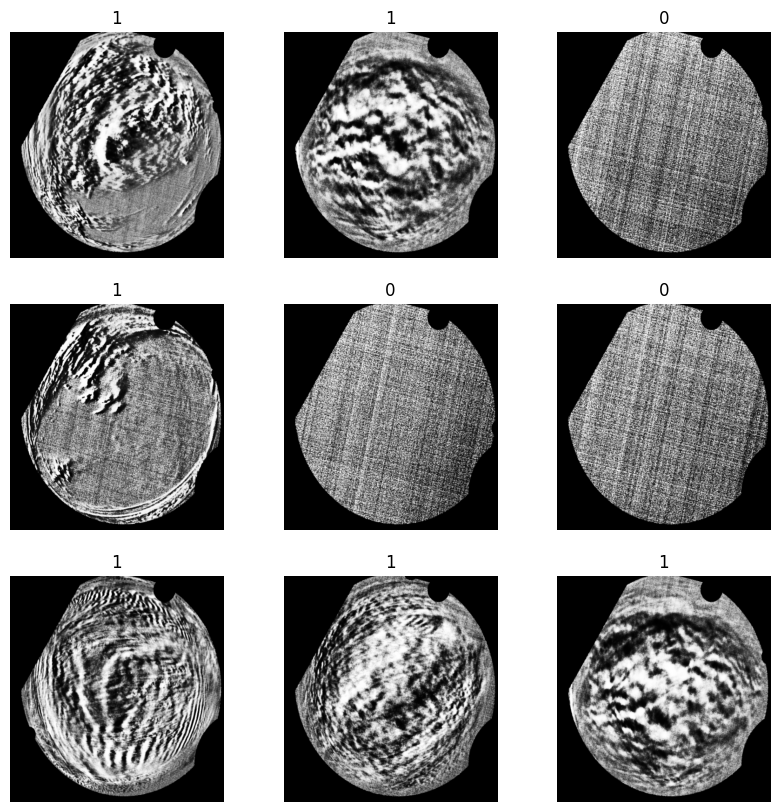

In [4]:

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")


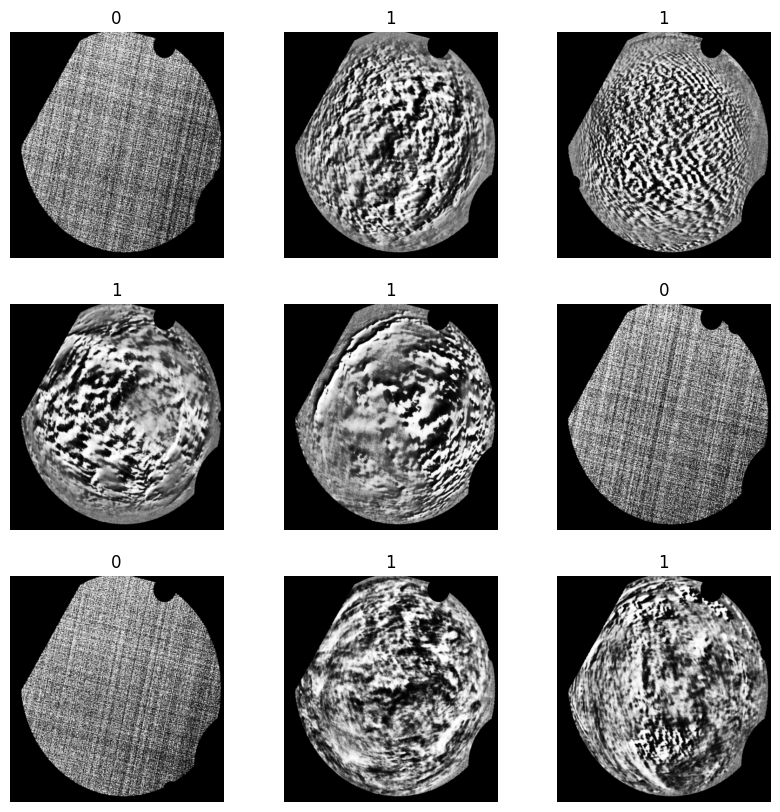

In [5]:

plt.figure(figsize=(10, 10))
for images, labels in val_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")


In [6]:
data_augmentation = keras.Sequential(
    [
#        layers.RandomFlip("horizontal"),
#        layers.RandomRotation(0.1),
    ]
)


In [7]:
train_ds = train_ds.map(
    lambda img, label: (data_augmentation(img), label),
    num_parallel_calls=tf.data.AUTOTUNE,
)

# Prefetching samples in GPU memory helps maximize GPU utilization.
train_ds = train_ds.prefetch(tf.data.AUTOTUNE)

val_ds = val_ds.prefetch(tf.data.AUTOTUNE)

In [8]:

def make_model(input_shape, num_classes):
    inputs = keras.Input(shape=input_shape)
    if num_classes == 2:
        activation = "sigmoid"
        units = 1
    else:
        activation = "softmax"
        units = num_classes
        
    # Entry block
    x = layers.Rescaling(1.0 / 255)(inputs)
    
    x = layers.Conv2D(32, 3, strides=2, padding="same")(x)
    #x = layers.BatchNormalization()(x)
    #x = layers.Activation("relu")(x)

#    previous_block_activation = x  # Set aside residual

#    for size in [256, 512, 728]:
#    for size in [32]:
#        x = layers.Activation("relu")(x)
#        x = layers.SeparableConv2D(size, 3, padding="same")(x)
#        x = layers.BatchNormalization()(x)

#        x = layers.Activation("relu")(x)
#        x = layers.SeparableConv2D(size, 3, padding="same")(x)
#        x = layers.BatchNormalization()(x)

#        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        # Project residual
#        residual = layers.Conv2D(size, 1, strides=2, padding="same")(
#            previous_block_activation
#        )
#        x = layers.add([x, residual])  # Add back residual
#        previous_block_activation = x  # Set aside next residual

#    x = layers.SeparableConv2D(1024, 3, padding="same")(x)


    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    x = layers.GlobalAveragePooling2D()(x)

    x = layers.Dropout(0.5)(x)
    outputs = layers.Dense(units, activation=activation)(x)
    return keras.Model(inputs, outputs)


model = make_model(input_shape=image_size + (3,), num_classes=2)

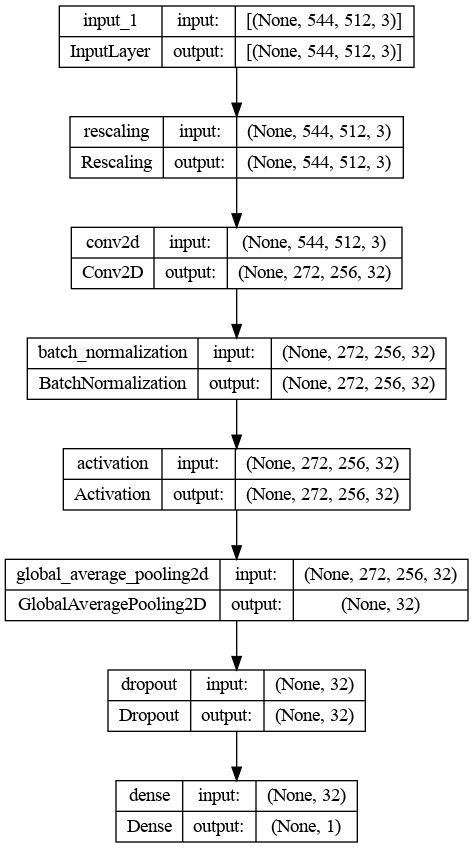

In [9]:
keras.utils.plot_model(model, show_shapes=True)


In [10]:

epochs = 10

callbacks = [
    keras.callbacks.ModelCheckpoint("save_at_{epoch}.keras"),
]
model.compile(
    optimizer=keras.optimizers.Adam(1e-3),
    loss="binary_crossentropy",
    metrics=["accuracy"],
)

model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 544, 512, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 544, 512, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 272, 256, 32)      896       
                                                                 
 batch_normalization (Batch  (None, 272, 256, 32)      128       
 Normalization)                                                  
                                                                 
 activation (Activation)     (None, 272, 256, 32)      0         
                                                                 
 global_average_pooling2d (  (None, 32)                0         
 GlobalAveragePooling2D)                                     

In [11]:
history = model.fit(
    train_ds,
    epochs=epochs,
    callbacks=callbacks,
    validation_data=val_ds,
)


Epoch 1/10
149/149 [==============================] - 50s 326ms/step - loss: 0.5238 - accuracy: 0.7930 - val_loss: 0.6726 - val_accuracy: 0.5345
Epoch 2/10
149/149 [==============================] - 50s 335ms/step - loss: 0.4398 - accuracy: 0.8774 - val_loss: 0.6510 - val_accuracy: 0.5345
Epoch 3/10
149/149 [==============================] - 50s 332ms/step - loss: 0.3738 - accuracy: 0.9051 - val_loss: 0.5211 - val_accuracy: 0.5345
Epoch 4/10
149/149 [==============================] - 51s 338ms/step - loss: 0.3307 - accuracy: 0.9118 - val_loss: 0.2845 - val_accuracy: 1.0000
Epoch 5/10
149/149 [==============================] - 49s 329ms/step - loss: 0.2802 - accuracy: 0.9270 - val_loss: 0.1900 - val_accuracy: 0.9950
Epoch 6/10
149/149 [==============================] - 50s 331ms/step - loss: 0.2523 - accuracy: 0.9383 - val_loss: 0.1524 - val_accuracy: 0.9882
Epoch 7/10
149/149 [==============================] - 50s 330ms/step - loss: 0.2329 - accuracy: 0.9391 - val_loss: 0.1389 - val_ac

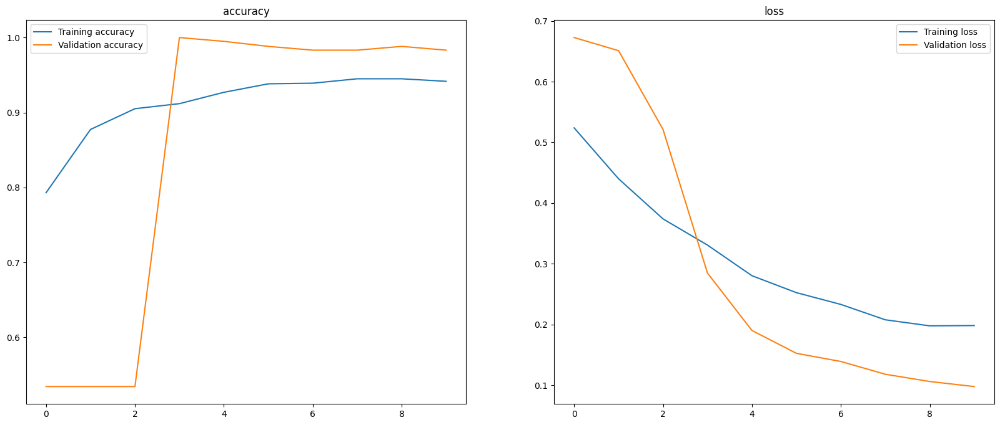

In [12]:
#model performance visualization
f = plt.figure(figsize=(20,8))

#accuracy
plt1 = f.add_subplot(121)
plt1.plot(history.history['accuracy'], label = str('Training accuracy'))
plt1.plot(history.history['val_accuracy'], label = str('Validation accuracy'))
plt.legend()
plt.title('accuracy')

#loss
plt2 = f.add_subplot(122)
plt2.plot(history.history['loss'], label = str('Training loss'))
plt2.plot(history.history['val_loss'], label = str('Validation loss'))
plt.legend()
plt.title('loss')

plt.show()

1/1 [==============================] - 0s 17ms/step


/tmp/ipykernel_609734/2774881498.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(1, 1))


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


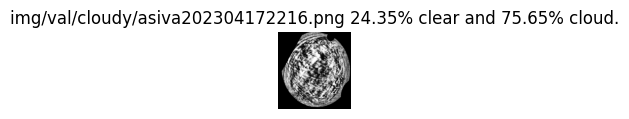

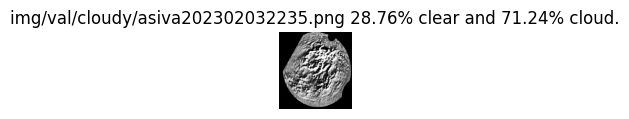

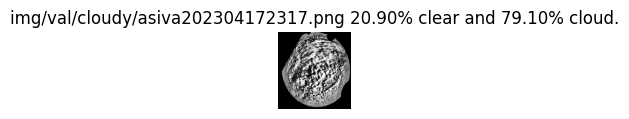

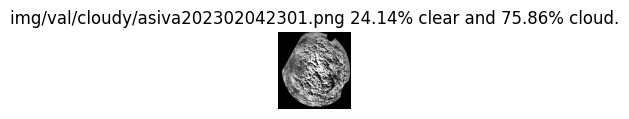

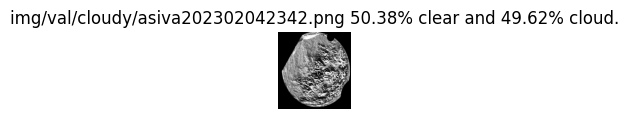

...

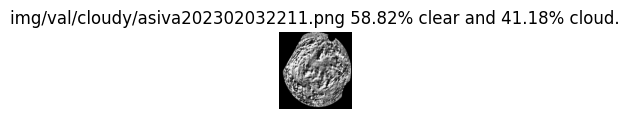

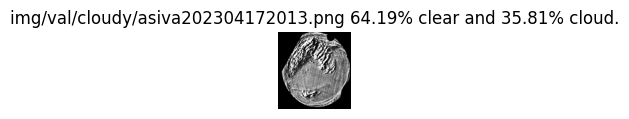

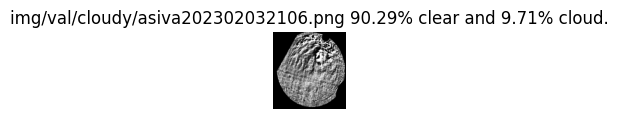

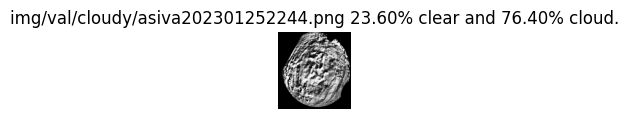

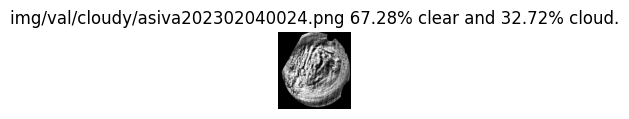

In [13]:
import glob
for i in glob.glob("img/val/cloudy/*.png"):
    img = keras.utils.load_img(i, target_size=image_size)
    img_array = keras.utils.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)  # Create batch axis

    predictions = model.predict(img_array)
    score = float(predictions[0])
    
    clear_score = 100 * (1 - score)
    cloudy_score = 100 * score
    
    if (clear_score > 20):
        plt.figure(figsize=(1, 1))
        plt.imshow(img)
        plt.title(f"{i} {clear_score:.2f}% clear and {cloudy_score:.2f}% cloud.")
        plt.axis("off")

